In [ ]:
# %% Use trained AstroCLIP model to embed entire dataset

from tqdm import tqdm
import lightning as L
from lightning.pytorch.callbacks import ModelCheckpoint
import torch
from datasets import load_dataset
from pl_bolts.models.self_supervised import Moco_v2
import torch.nn.functional as F
import torch.optim.lr_scheduler as lr_scheduler
from src.models import OutputExtractor, ExtendedSpender, AstroCLIP, AlternateSpender
from torch.utils.data import Subset, DataLoader
from torchvision.transforms import (
    Compose,
    RandomVerticalFlip,
    RandomHorizontalFlip,
    RandomRotation,
    RandomErasing,
    ToTensor,
    CenterCrop,
    ToPILImage,
    InterpolationMode,
)
from pytorch_lightning.loggers import WandbLogger
import numpy as np
from src.utils import dr2_rgb

import matplotlib.pyplot as plt

print("imports done")

c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\pl_bolts\__init__.py:11: FutureWarning: In the future `np.object` will be defined as the corresponding NumPy scalar.
  if not hasattr(numpy, tp_name):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\pl_bolts\__init__.py:11: FutureWarning: In the future `np.bool` will be defined as the corresponding NumPy scalar.
  if not hasattr(numpy, tp_name):


imports done


c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\pl_bolts\models\self_supervised\amdim\amdim_module.py:34: UnderReviewWarning: The feature generate_power_seq is currently marked under review. The compatibility with other Lightning projects is not guaranteed and API may change at any time. The API and functionality may change without warning in future releases. More details: https://lightning-bolts.readthedocs.io/en/latest/stability.html
  "lr_options": generate_power_seq(LEARNING_RATE_CIFAR, 11),
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\pl_bolts\models\self_supervised\amdim\amdim_module.py:92: UnderReviewWarning: The feature FeatureMapContrastiveTask is currently marked under review. The compatibility with other Lightning projects is not guaranteed and API may change at any time. The API and functionality may change without warning in future releases. More details: https://lightning-bolts.readthedocs.io/en/latest/stability.html
  contrastive_task: Union[Fe

In [ ]:
# %%

# Load the embeddings
emb = np.load("data/embeddings-alt1.npz")
source_images = emb["images"]
im_embeddings = emb["im_embeddings"]
spectra = emb["spectra"]
redshifts = emb["redshifts"]
source_spec = emb["source_spec"]

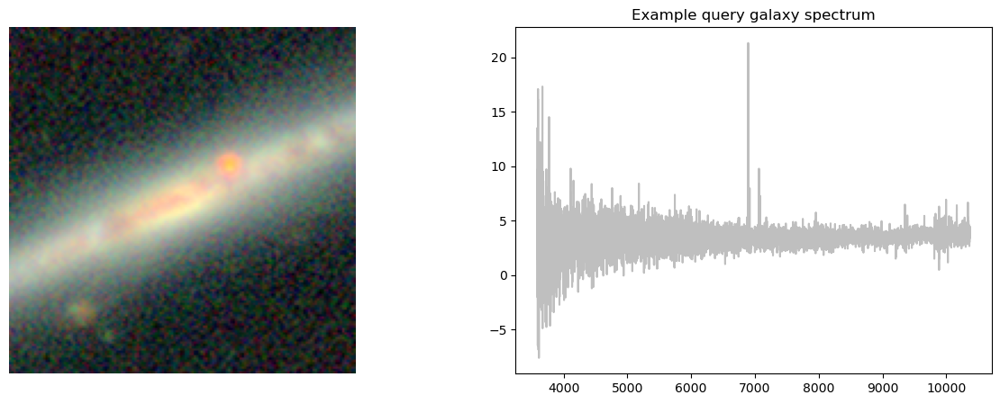

In [ ]:
# %%

import torch.nn.functional as F

l = np.linspace(3586.7408577, 10372.89543574, len(source_spec[0]))
ind_query = 12
plt.figure(figsize=[15, 5])
plt.subplot(1, 2, 1)
plt.imshow(source_images[ind_query])
plt.axis("off")
plt.subplot(1, 2, 2)
plt.plot(l, source_spec[ind_query], color="grey", alpha=0.5)
plt.title("Example query galaxy spectrum")

# normalise the embedding by diving by the L2 norm
# image_features = im_embeddings / np.linalg.norm(im_embeddings, axis=-1, keepdims=True)
# spectra_features = spectra / np.linalg.norm(spectra, axis=-1, keepdims=True)

image_features = F.normalize(torch.tensor(im_embeddings), p=2, dim=-1).numpy()
spectra_features = F.normalize(torch.tensor(spectra), p=2, dim=-1).numpy()

# compute the similarity between the query spectrum and all the image embeddings (i.e. dot product)
cross_sp = spectra_features[ind_query] @ image_features.T  # vector of similarity scores

Query with spectrum-> image cross similarity


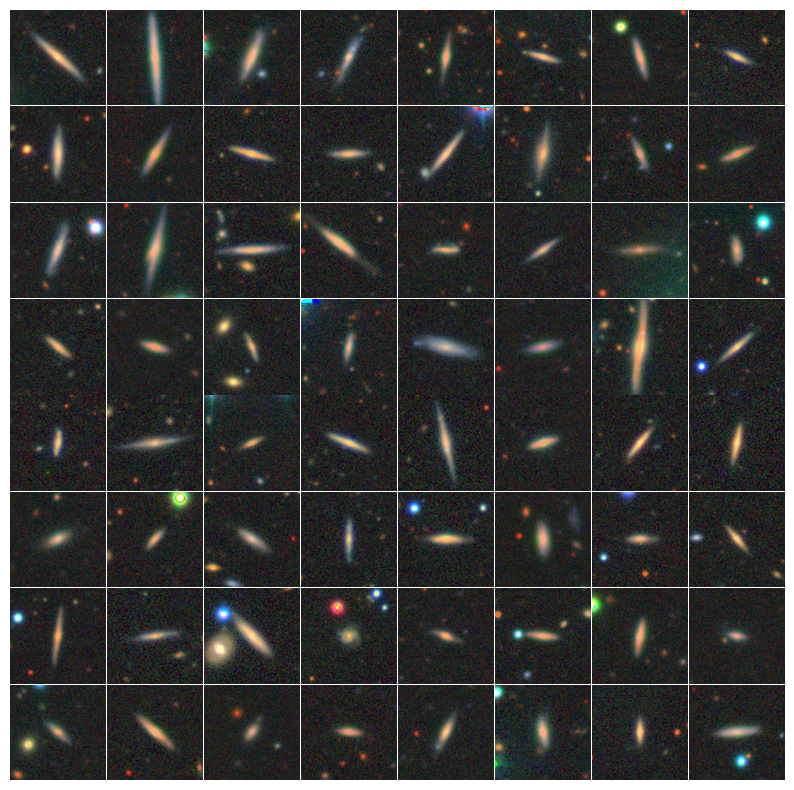

In [ ]:
# %% Spectrum query -> top 64 image retrieval

# Sort the indices of the 'similarity' array in descending order
print("Query with spectrum-> image cross similarity")
ind_sorted = np.argsort(cross_sp)[::-1]
plt.figure(figsize=[10, 10])
for i in range(8):
    for j in range(8):
        plt.subplot(8, 8, i * 8 + j + 1)
        plt.imshow(source_images[ind_sorted[i * 8 + j]])
        plt.axis("off")
plt.subplots_adjust(wspace=0.01, hspace=0.01)

<>:90: SyntaxWarning: invalid escape sequence '\-'
<>:90: SyntaxWarning: invalid escape sequence '\-'
<ipython-input-5-e0b0558f2f8c>:90: SyntaxWarning: invalid escape sequence '\-'
  plt.title("Cross Image-Spectra\-Similarity")


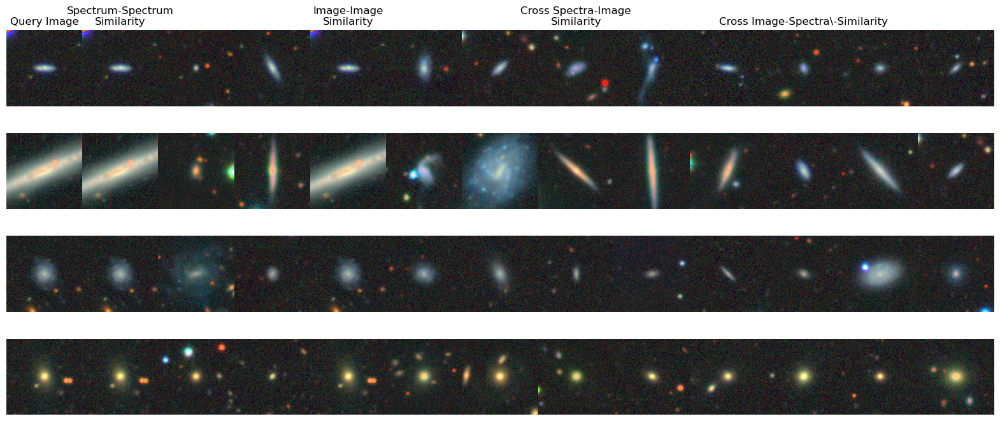

In [ ]:
# %%

import numpy as np

ind_queries = [4, 12, 29, 23]
results = {
    "images_sp_sp": [],  # Spectral query, spectral retrieval (sp_sim)
    "images_im_im": [],  # Image query, image retrieval (im_sim)
    "images_sp_im": [],  # Spectral query, image retrieval (cross_sp_sim)
    "images_im_sp": [],  # Image query, spectral retrieval (cross_im_sim)
    "spectra_sp_sp": [],  # Spectral query, spectral retrieval (sp_sim)
    "spectra_im_im": [],  # Image query, spectral retrieval (im_sim)
    "spectra_sp_im": [],  # Spectral query, image retrieval (cross_sp_sim)
    "spectra_im_sp": [],  # Image query, spectral retrieval (cross_im_sim)
}

for ind_query in ind_queries:
    sp_sim = spectra_features[ind_query] @ spectra_features.T
    im_sim = image_features[ind_query] @ image_features.T
    cross_im_sim = image_features[ind_query] @ spectra_features.T
    cross_sp_sim = spectra_features[ind_query] @ image_features.T

    results["images_sp_sp"].append(
        [source_images[i] for i in np.argsort(sp_sim)[::-1][:8]]
    )
    results["images_im_im"].append(
        [source_images[i] for i in np.argsort(im_sim)[::-1][:8]]
    )
    results["images_sp_im"].append(
        [source_images[i] for i in np.argsort(cross_sp_sim)[::-1][:8]]
    )
    results["images_im_sp"].append(
        [source_images[i] for i in np.argsort(cross_im_sim)[::-1][:8]]
    )

    results["spectra_sp_sp"].append(
        [source_spec[i] for i in np.argsort(sp_sim)[::-1][:8]]
    )
    results["spectra_im_im"].append(
        [source_spec[i] for i in np.argsort(im_sim)[::-1][:8]]
    )
    results["spectra_sp_im"].append(
        [source_spec[i] for i in np.argsort(cross_sp_sim)[::-1][:8]]
    )
    results["spectra_im_sp"].append(
        [source_spec[i] for i in np.argsort(cross_im_sim)[::-1][:8]]
    )

# The results dictionary now holds the top similar images and spectra for each query index.

plt.figure(figsize=[20, 10])
for n, i in enumerate(ind_queries):
    # Plot query image
    plt.subplot(5, 13, n * 13 + 1)
    plt.imshow(source_images[i])
    plt.axis("off")
    if n == 0:
        plt.title("Query Image")

    # Image similarity
    for j in range(3):
        plt.subplot(5, 13, n * 13 + j + 1 + 1)
        plt.imshow(results["images_sp_sp"][n][j])
        plt.axis("off")
        if n == 0 and j == 0:
            plt.title("Spectrum-Spectrum\nSimilarity")

    # Spectra similarity
    for j in range(3):
        plt.subplot(5, 13, n * 13 + j + 1 + 3 + 1)
        plt.imshow(results["images_im_im"][n][j])
        plt.axis("off")
        if n == 0 and j == 0:
            plt.title("Image-Image\nSimilarity")

    # Cross image similarity (spectral query, image retrieval)
    for j in range(3):
        plt.subplot(5, 13, n * 13 + j + 1 + 6 + 1)
        plt.imshow(results["images_sp_im"][n][j])
        plt.axis("off")
        if n == 0 and j == 0:
            plt.title("Cross Spectra-Image\nSimilarity")

    # Cross spectrum similarity (image query, spectral retrieval)
    for j in range(3):
        plt.subplot(5, 13, n * 13 + j + 1 + 9 + 1)
        plt.imshow(results["images_im_sp"][n][j])
        plt.axis("off")
        if n == 0 and j == 0:
            plt.title("Cross Image-Spectra\-Similarity")

plt.subplots_adjust(wspace=0.0, hspace=0.3)
# plt.savefig('retrieval.png', bbox_inches='tight', pad_inches=0)
plt.show()

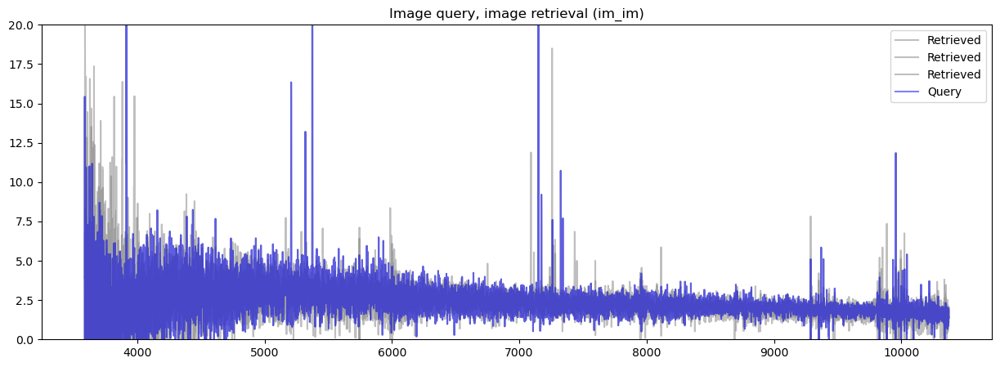

In [ ]:
# %% Plot spectral retrieval

query_sp = source_spec[4]
plt.figure(figsize=[15, 5])

plt.title("Image query, image retrieval (im_im)")
plt.ylim(-0, 20)
for j in range(3):
    plt.plot(
        l, results["spectra_im_im"][0][j], color="grey", alpha=0.5, label="Retrieved"
    )
plt.plot(l, query_sp, color="blue", alpha=0.5, label="Query")
plt.legend()
plt.show()

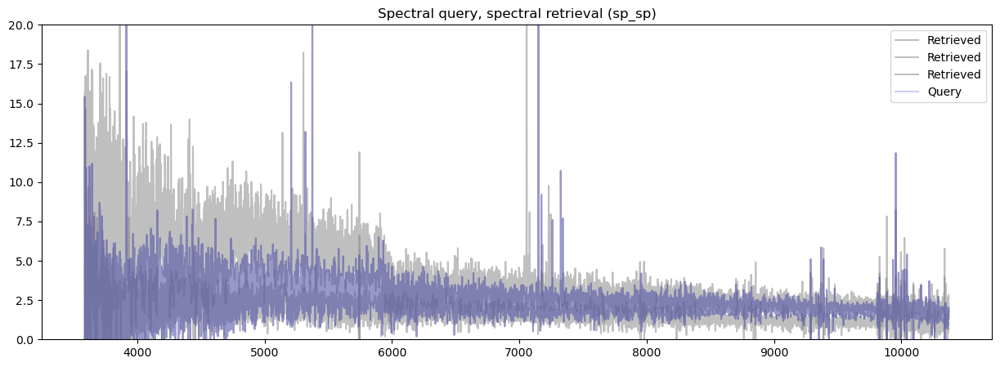

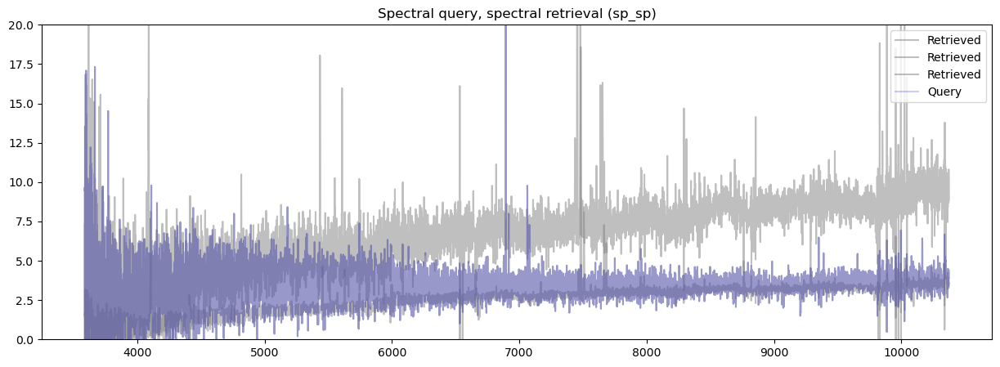

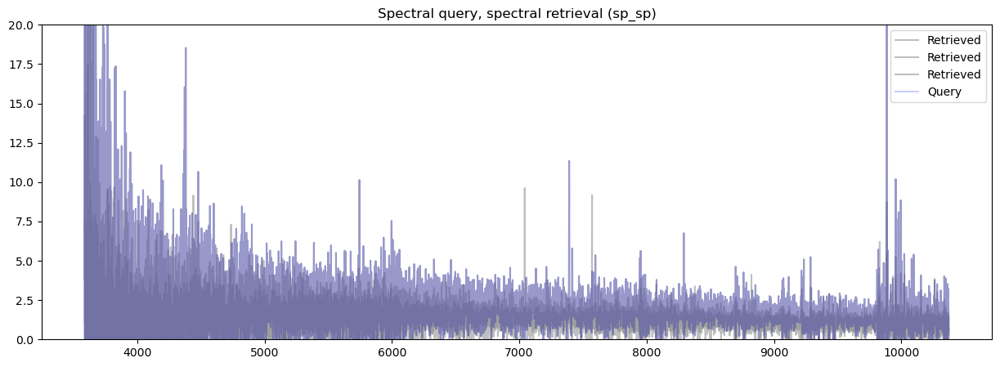

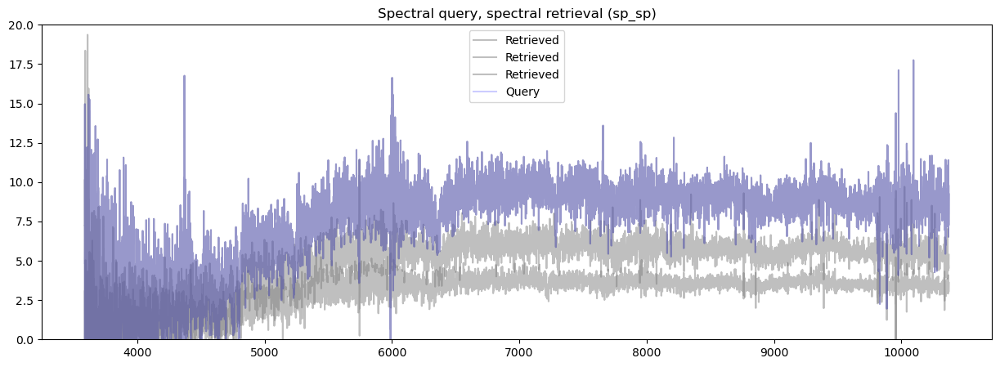

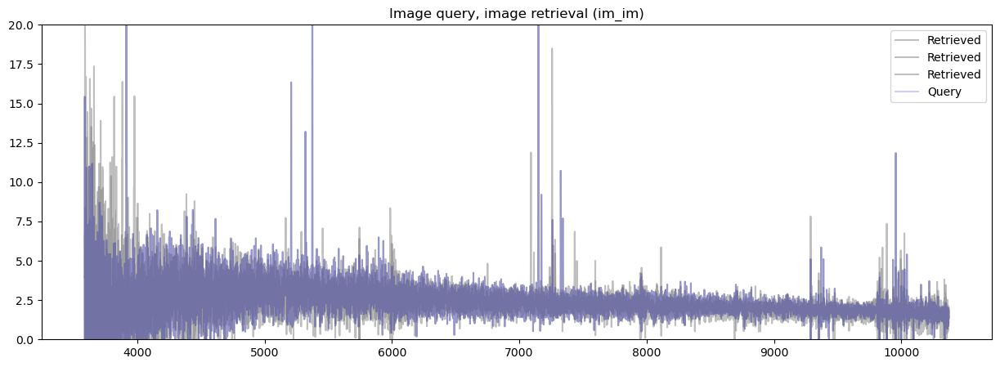

...

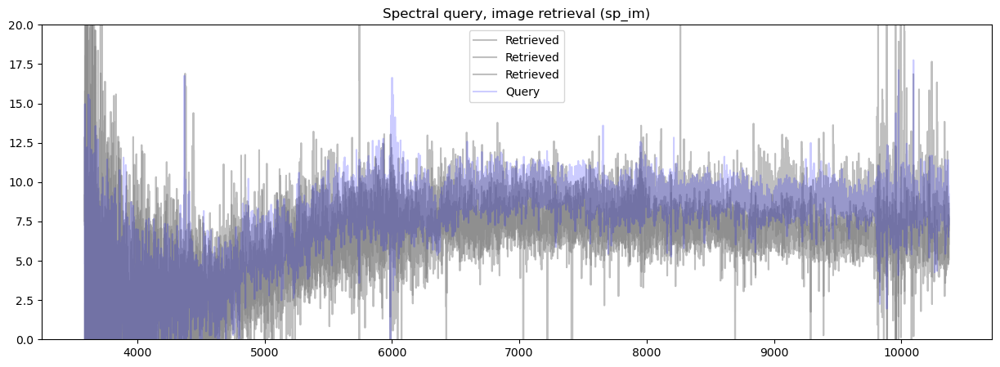

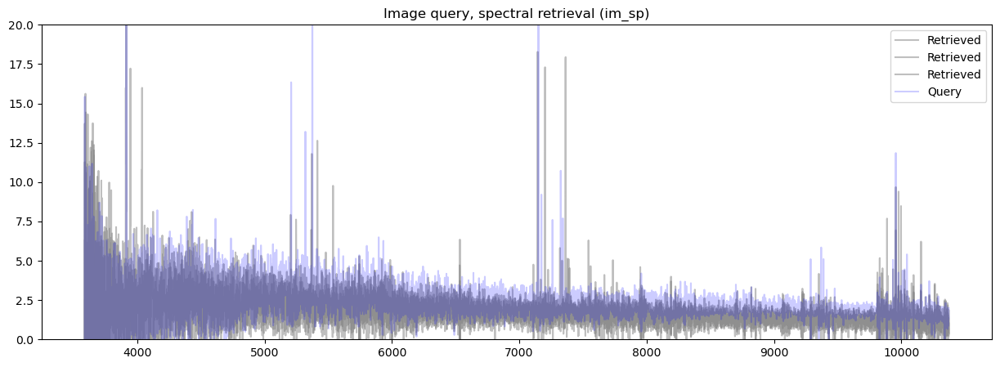

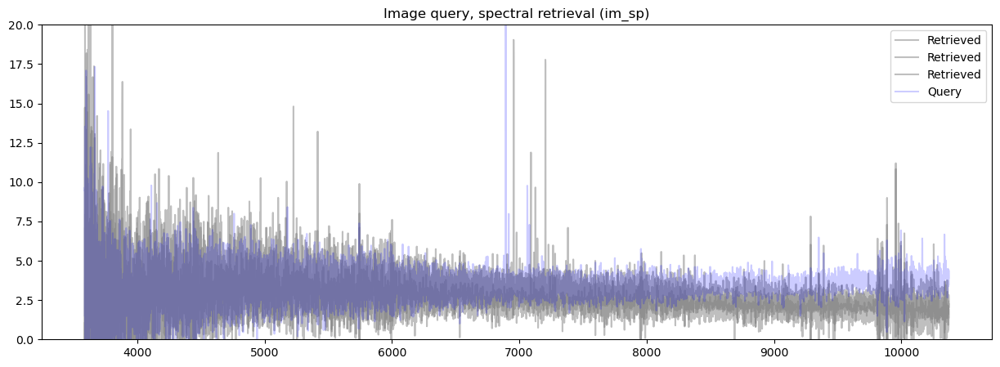

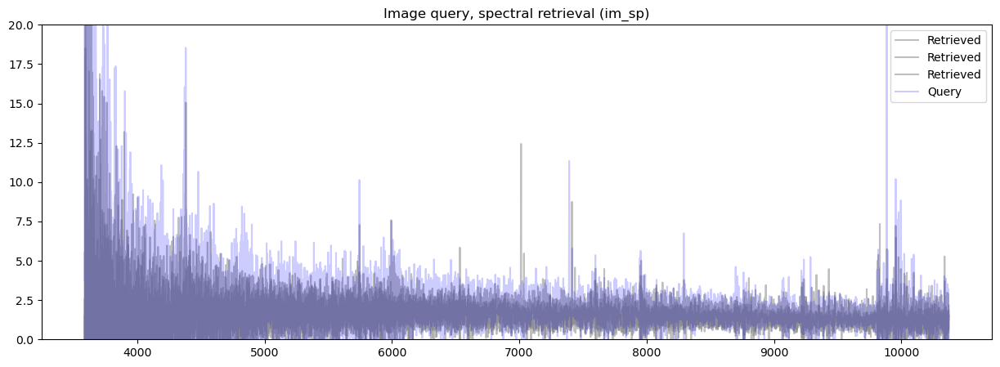

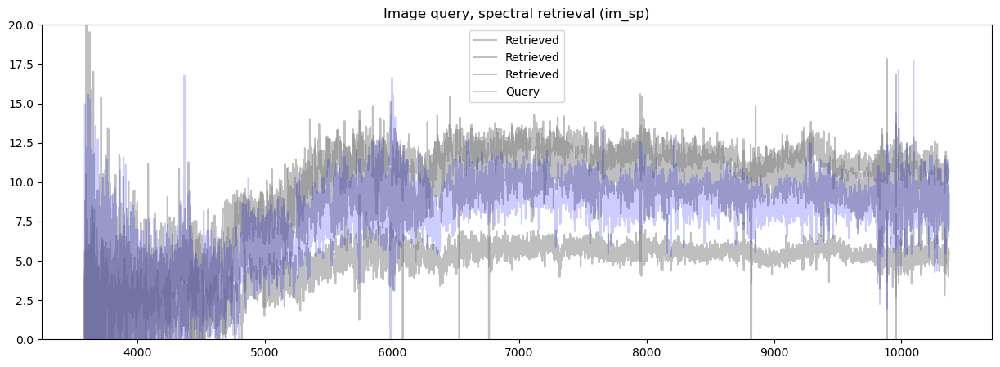

In [ ]:
# %% Do the same looping over all ind queries

# spectra sp_sp
for n, i in enumerate(ind_queries):
    query_sp = source_spec[i]
    plt.figure(figsize=[15, 5])

    plt.title("Spectral query, spectral retrieval (sp_sp)")
    plt.ylim(-0, 20)
    for j in range(3):
        plt.plot(
            l,
            results["spectra_sp_sp"][n][j],
            color="grey",
            alpha=0.5,
            label="Retrieved",
        )
    plt.plot(l, query_sp, color="blue", alpha=0.2, label="Query")
    plt.legend()
    plt.show()


# spectra im_im
for n, i in enumerate(ind_queries):
    query_sp = source_spec[i]
    plt.figure(figsize=[15, 5])

    plt.title("Image query, image retrieval (im_im)")
    plt.ylim(-0, 20)
    for j in range(3):
        plt.plot(
            l,
            results["spectra_im_im"][n][j],
            color="grey",
            alpha=0.5,
            label="Retrieved",
        )
    plt.plot(l, query_sp, color="blue", alpha=0.2, label="Query")
    plt.legend()
    plt.show()


# spectra sp_im
for n, i in enumerate(ind_queries):
    query_sp = source_spec[i]
    plt.figure(figsize=[15, 5])

    plt.title("Spectral query, image retrieval (sp_im)")
    plt.ylim(-0, 20)
    for j in range(3):
        plt.plot(
            l,
            results["spectra_sp_im"][n][j],
            color="grey",
            alpha=0.5,
            label="Retrieved",
        )
    plt.plot(l, query_sp, color="blue", alpha=0.2, label="Query")
    plt.legend()
    plt.show()


# spectra im_sp
for n, i in enumerate(ind_queries):
    query_sp = source_spec[i]
    plt.figure(figsize=[15, 5])

    plt.title("Image query, spectral retrieval (im_sp)")
    plt.ylim(-0, 20)
    for j in range(3):
        plt.plot(
            l,
            results["spectra_im_sp"][n][j],
            color="grey",
            alpha=0.5,
            label="Retrieved",
        )
    plt.plot(l, query_sp, color="blue", alpha=0.2, label="Query")
    plt.legend()
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


array([[[255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.],
        ...,
        [255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.]],

       [[255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.],
        ...,
        [255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.]],

       [[255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.],
        ...,
        [255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.]],

       ...,

       [[255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.],
        ...,
        [255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.]],

       [[255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.],
        ...,
        [255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.]],

       [[255., 255., 255.],
        [255., 255., 255.],
        [255., 2

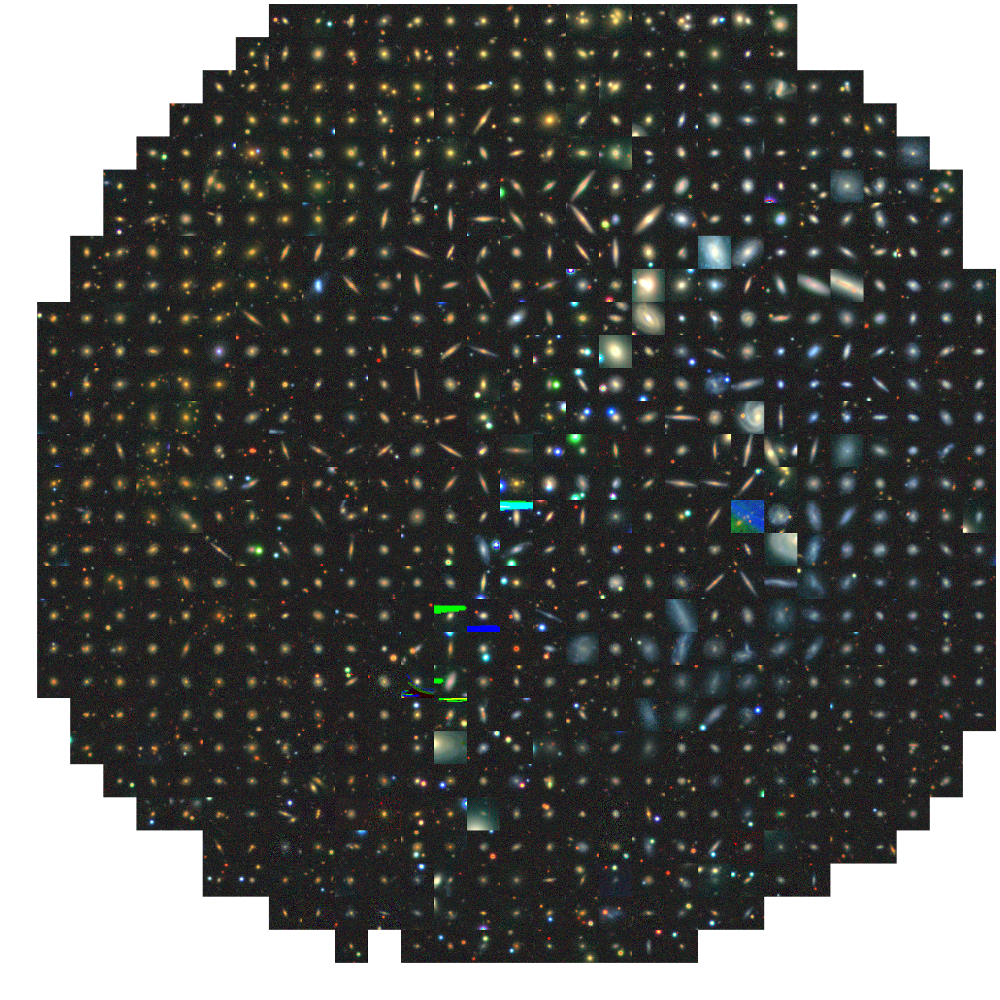

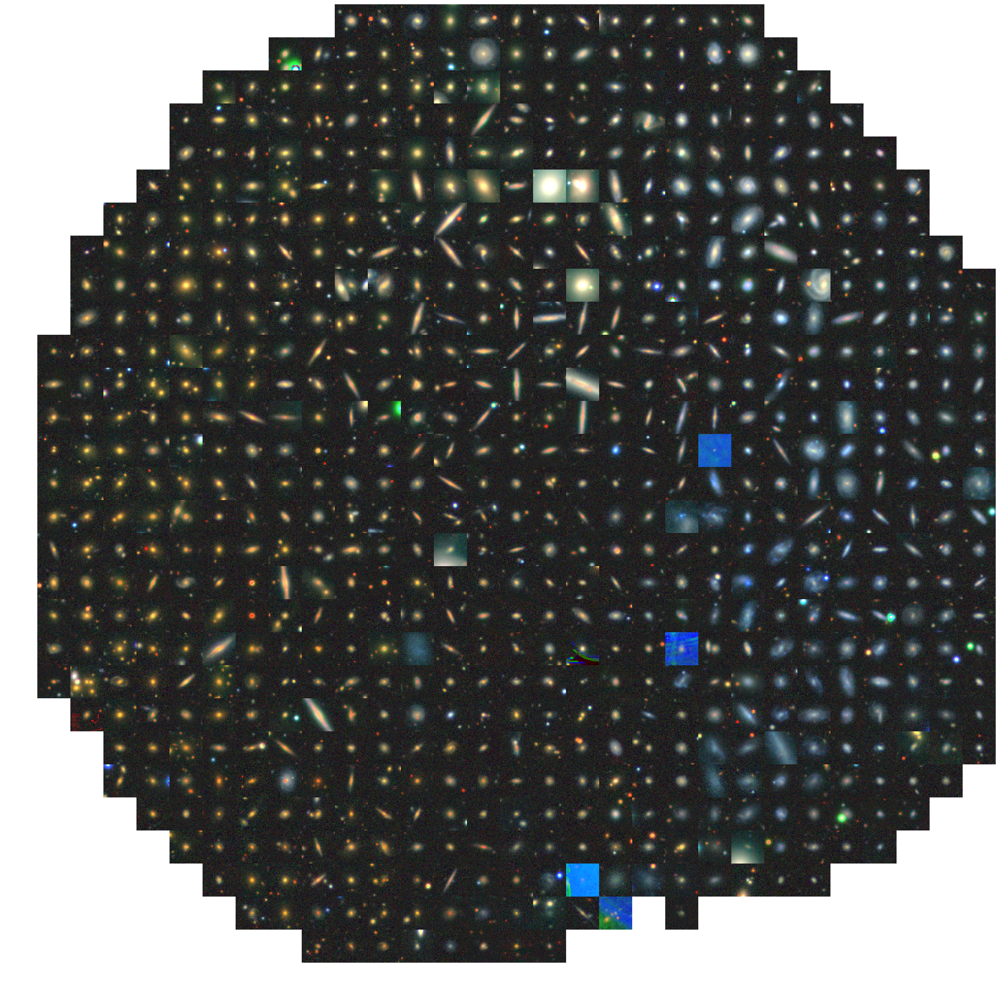

In [ ]:
# %% visualise the embeddings

from sklearn.decomposition import PCA
from src.utils import scatter_plot_as_images
from sklearn.neighbors import NearestNeighbors
from matplotlib.pyplot import plot, ylim, title, legend

im_pca = PCA(n_components=4).fit_transform(image_features)
sp_pca = PCA(n_components=4).fit_transform(spectra_features)
scatter_plot_as_images(im_pca, source_images, nx=30, ny=30)
scatter_plot_as_images(sp_pca, source_images, nx=30, ny=30)

In [ ]:
# %%

# Load the embeddings
emb = np.load("data/embeddings-alt1.npz")
source_images = emb["images"]
im_embeddings = emb["im_embeddings"]
spectra = emb["spectra"]
redshifts = emb["redshifts"]
source_spec = emb["source_spec"]

Zero shot redshift prediction from image features


c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be rem

Text(0.05, 0.55, '$R^2$ score: 0.28')

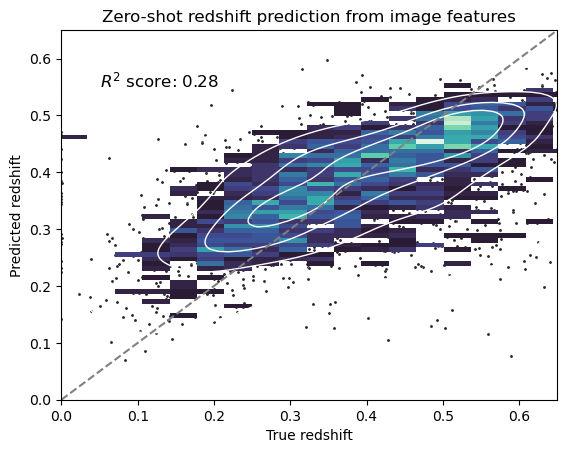

In [ ]:
# %% Zero shot redshift prediction

from sklearn.neighbors import KNeighborsRegressor
import seaborn as sns
from sklearn.metrics import r2_score

print("Zero shot redshift prediction from image features")

neigh = KNeighborsRegressor(weights="distance", n_neighbors=50)
neigh.fit(image_features[:-3000], redshifts[:-3000])
preds = neigh.predict(image_features[-3000:])


sns.scatterplot(x=redshifts[-3000:], y=preds, s=5, color=".15")
sns.histplot(x=redshifts[-3000:], y=preds, bins=64, pthresh=0.1, cmap="mako")
sns.kdeplot(x=redshifts[-3000:], y=preds, levels=5, color="w", linewidths=1)
plt.xlabel("True redshift")
plt.ylabel("Predicted redshift")
plt.plot([0, 1], [0, 1], color="grey", linestyle="--")
plt.title("Zero-shot redshift prediction from image features")
plt.xlim(0, 0.65)
plt.ylim(0, 0.65)
plt.text(
    0.05,
    0.55,
    "$R^2$ score: %0.2f" % (r2_score(redshifts[-3000:], preds)),
    fontsize="large",
)

c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be rem

Text(0.05, 0.55, '$R^2$ score: 0.58')

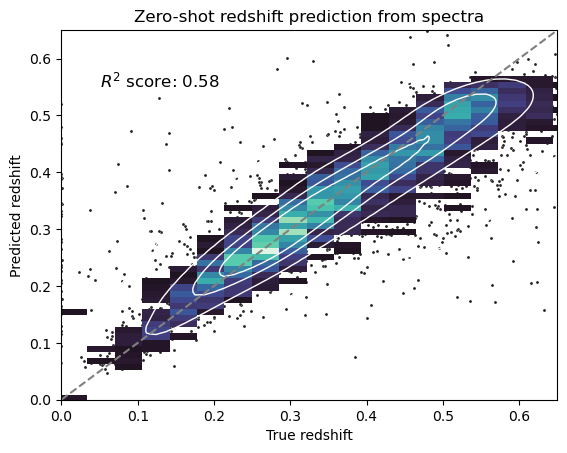

In [ ]:
# %% from spectra

neigh = KNeighborsRegressor(weights="distance", n_neighbors=16)
neigh.fit(spectra[:-5000], redshifts[:-5000])
preds = neigh.predict(spectra[-5000:])
sns.scatterplot(x=redshifts[-5000:], y=preds, s=5, color=".15")
sns.histplot(x=redshifts[-5000:], y=preds, bins=64, pthresh=0.1, cmap="mako")
sns.kdeplot(x=redshifts[-5000:], y=preds, levels=5, color="w", linewidths=1)
plt.xlabel("True redshift")
plt.ylabel("Predicted redshift")
plt.title("Zero-shot redshift prediction from spectra")
plt.plot([0, 1], [0, 1], color="grey", linestyle="--")
plt.xlim(0, 0.65)
plt.ylim(0, 0.65)
plt.text(
    0.05,
    0.55,
    "$R^2$ score: %0.2f" % (r2_score(redshifts[-5000:], preds)),
    fontsize="large",
)